# Classification

## Introduction

Suppose that instead of a *quantitative* outcome variable $Y$, we have a *qualitative* one. We are interested in predicting this outcome, which in this setting would be a *classification* problem.

**Note:** we can also predict the probability of each of the categories of a qualitative variable, hence we can (and we will!) use regression methods.

As before, we have a sample $\left\{\left(\mathbf{x}_{1}, y_{1}\right), \ldots,\left(\mathbf{x}_{n}, y_{n}\right)\right\}$, which we will now use to build a *classifier*. This classifier should perform well not only on the training data, but on test observations that were not used to train the classifier.

**Example:** How to build a model to predict default ($Y$) for any given value of balance ($X_1$) and income ($X_2$). 

![fig_default_I.png](fig_default_I.png)

## Why not linear regression?

We have stated that linear regression is not appropriate in the case of a qualitative response. Why not?

1. Coding qulitative responses does not always makes sense.
2. Some of our estimates (fitted values) may be outside the coding range!

**Example:** we would like to predict the medical condition of a patient on the basis of her symptoms. Suppose there are three possible diagnoses: stroke, drug overdose, and epileptic seizure. How can we encode these values as a quantitative response variable? 


\begin{equation}
Y=\left\{\begin{array}{ll}{1,} & {\text { if stroke }} \\ {2,} & {\text { if drug overdose }} \\ {3,} & {\text { if epileptic seizure. }}\end{array}\right.
\end{equation}

Now, use least squares to fit a linear regression model to predict $Y$ on the basis of a set of predictors $X_1, . . .,Xp$. 


But this coding implies

- an *ordering* on the outcomes;
- the *same* difference between stroke and drug overdose and between drug overdose and epileptic seizure.

Does it make sense?

Maybe we can still do the coding in the case of a binary response (only stroke and drug overdose)?

In this very special case, we can use linear regression. And $\mathbf{X}\hat{\boldsymbol{\beta}}$ is indeed a good estimator, but of $\mathbb{P}\big(\text {drug overdose } | \mathbf{X}\big)$! However, there is no guarantee that $\mathbf{X}\hat{\boldsymbol{\beta}}$ lies inside $[0,1]$.

## Logistic regression

Logistic regression models the *probability* that $Y$ belongs to a particular category.


For the example in the **Introduction** logistic regression models the probability of default:

\begin{equation}
\mathbb{P}\big(\text {default }=\text { Yes } | \text { balance}\big)=p(\text{balance}) \in [0,1].
\end{equation}

To make predictions, we might predict $\text{default} = \text{Yes}$ for any individual for whom $p(\text{balance}) > 0.5.$ 


Formally, let us define $p(X)$ as the probability of a binary outcome $Y$ being equal to $1$ given $X$: as a linear function of $X$:

\begin{equation}
\mathbb{P}\big( Y= 1| X):= p(X).
\end{equation}

We can either assume that $p(X)$ is linear in $X$
\begin{equation}
p(X) =\beta_{1}+\beta_{2} X,
\end{equation}

or we can use the logistic relationship:

\begin{equation}
p(X)=\frac{e^{\beta_{1}+\beta_{2} X}}{1+e^{\beta_{1}+\beta_{2} X}}.
\end{equation}

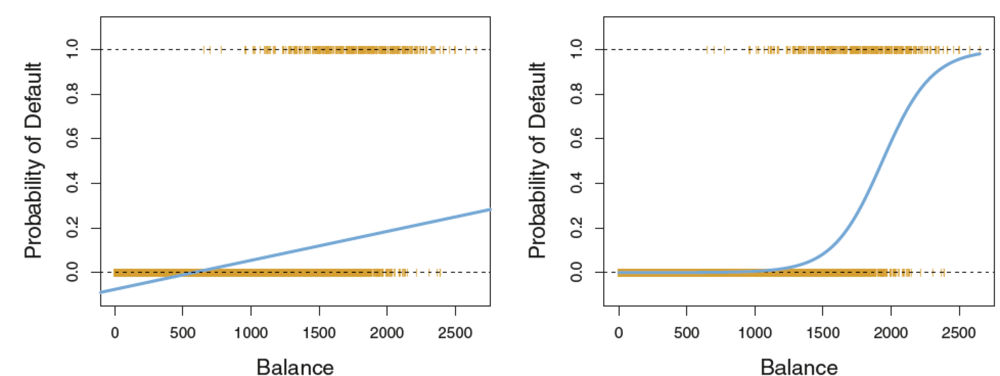


After some manipulations:
\begin{equation}
\frac{p(X)}{1-p(X)}=e^{\beta_{1}+\beta_{2} X}
\end{equation}

This quantity is called *the odds* (can be anything between $0$ and $\infty$).
 
Taking the logarithm on both sides yields the log-odds or **logit**.

\begin{equation}
\log \left(\frac{p(X)}{1-p(X)}\right)=\beta_{1}+\beta_{2} X
\end{equation}

However, because the relationship between $p(X)$ and $X$ is not a straight line, $\beta_2$ does not correspond to the change in $p(X)$ associated with a one-unit increase in $X$. The amount that $p(X)$ changes due to a one-unit change in $X$ will depend on the current value of $X$. 

But regardless of the value of $X$, we have the following rule:
 - if $\beta_2$ is positive then increasing $X$ will be associated with increasing $p(X)$,
 - if $\beta_2$ is negative then increasing $X$ will be associated with decreasing $p(X)$.

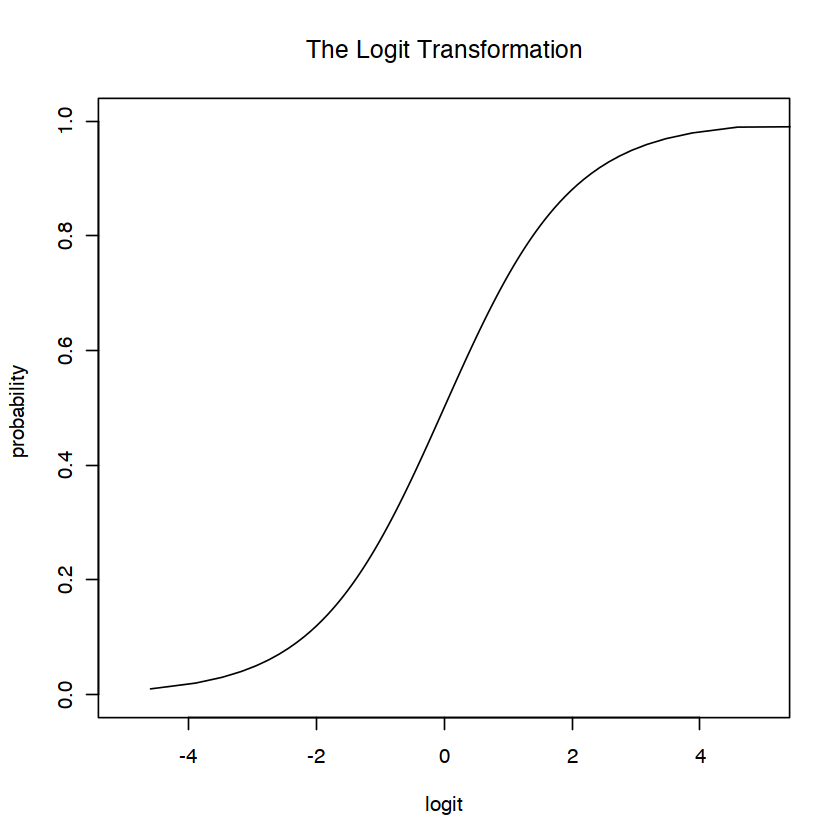

In [1]:
##The logit transformation#

####Generate a vector of probabilities########
p <- seq(0,0.99999999,le=100)

logit <- function(x) {
  logit <-log(x / (1 - x))
  return(logit)
}

plot(logit(p), p, type = "l", xlim = c(-5,5), main = "The Logit Transformation",
     xlab = "logit", ylab = "probability ", cex.main = 1.2, cex.lab = 1, cex.axis = 1)

We find the estimates of $\beta_1$ and $\beta_2$ using the maximum likelihood method. The basic idea of it is that we seek the estimates of the parameters such that the predicted probability $\hat{p}(x_i)$ of $y_i = 1$ for each individual corresponds as closely as possible to the individual's observed status.

This intuition can be formalised using a likelihood function:

$$ l(\beta_1, \beta_2) = \prod_{i: y_i = 1} p(x_i) \prod_{i^\prime: y_{i^\prime} = 0} \big( 1 - p(x_{i^\prime})\big).
$$

The vector of estimators $(\hat{\beta}_1, \hat{\beta}_2)$ is chosen to maximize the likelihood function. 

In [6]:
##General Syntax###

library(miscTools) #the maxLik package acts as a wrapper for the more basic "optim", the library miscTools is required.
library(maxLik)

loglike<-function(beta)#Define a function that takes only the parameter vector as arguments.
{
  ll <- "my log likelihood function" #depending on your optimization routine, 
  #check whether you need the negative or the positive log likelihood!
  return(ll)
}

estim <- maxBFGS(loglike, finalHessian=TRUE, start = c(.,.))###initialize the optimization, 
#pass on starting values and store the results in estim
estim.par <- estim$estimate ### store the paramter estimates in a variable "estim.par"

**Example:**
1. Simulate this model with the probabilities as described above with the following values:

- $n =1000$
- $\beta_1=-2, \, \beta_2=0.1,\, \, \, \beta_3=1$.
- $x_{1i}=1 \, \forall \,i$ , $x_{2i}\sim \mathcal{U}(18,60), \, x_{3i}\sim \mathcal{B}(0.5)$. 

2. Estimate $\beta_1, \beta_2, \beta_3$ via maximum likelihood and calculate the standard errors.

In [3]:
###An empirical example for the logit model##  
set.seed(40)  
library(miscTools)
library(maxLik)
n     <- 1000#sample size
beta1 <- -2  #coefficient on the intercept
beta2 <- 0.1 #coefficient on the regressor
beta3 <- 1
beta  <- cbind(beta1, beta2, beta3)
x2    <- sort(runif(n = n, min = 18, max = 60))#generating the regressor
x3    <- rbinom(n, 1, 0.5)
pi_x  <- exp(beta1 + beta2 * x2 + beta3 * x3) / (1 + exp(beta1 + beta2 * x2 + beta3 * x3))
#generating the probabilities for the binomial

y <- rbinom(n = n, size = 1, prob = pi_x)#drawing y with the transformed logit probabilities
X <- cbind(rep(1, n), x2, x3)

loglike <- function(beta_)#the likelihood function for the logit model
{
  ll <- sum(-y * log(1 + exp(-(X %*% beta_))) - (1 - y) * log(1 + exp(X %*% beta_)))
  return(ll)
}
estim      <- maxBFGS(loglike, finalHessian=TRUE, start=c(0,1,1))#initialize estimation procedure.
estim.par  <- estim$estimate# give out parameter estimates.
estim.par
estim.hess <- estim$hessian###the optimization routine returns the hessian matrix at the last iteration.
Cov        <- -(solve(estim.hess))##the covariance matrix is the (negative) inverse of the hessian matrix.
sde        <- sqrt(diag(Cov))#the standard errors are the square root of the diagonal of the inverse Hessian. 
sde


Please cite the 'maxLik' package as:
Henningsen, Arne and Toomet, Ott (2011). maxLik: A package for maximum likelihood estimation in R. Computational Statistics 26(3), 443-458. DOI 10.1007/s00180-010-0217-1.

If you have questions, suggestions, or comments regarding the 'maxLik' package, please use a forum or 'tracker' at maxLik's R-Forge site:
https://r-forge.r-project.org/projects/maxlik/



[1] -2.0573660  0.1040998  0.7349992

[1] 0.35754704 0.01061589 0.20389410

### Predictions

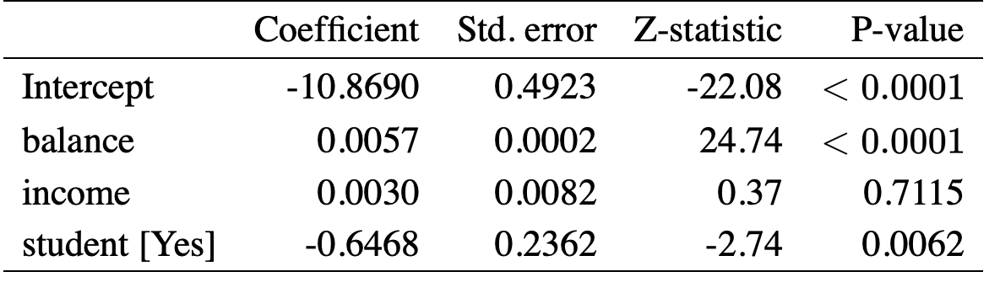


For example: student with a credit card balance of 1,500 and an income of 40,000 has an estimated probability
of default of

\begin{equation}
\hat{p}(X)=\frac{e^{-10.869+0.00574 \times 1,500+0.003 \times 40-0.6468 \times 1}}{1+e^{-10.869+0.00574 \times 1,500+0.003 \times 40-0.6468 \times 1}}=0.058
\end{equation}

A non-student with the same balance and income has an estimated probability
of default of

\begin{equation}
\hat{p}(X)=\frac{e^{-10.869+0.00574 \times 1,500+0.003 \times 40-0.6468 \times 0}}{1+e^{-10.869+0.00574 \times 1,500+0.003 \times 40-0.6468 \times 0}}=0.105
\end{equation}




### How to interpret parameter estimates?

Here are the estimated coeeficientd of the logistic regression model that predicts the probability of `default` using only the student status:

![logit_coefficients.png](logit_coefficients.png)

How is it possible for student status to be associated with an *increase* in probability of default here and a *decrease* in probability of default in the model above?

The negative coefficient for `student` in the multiple logistic regression indicates that for a fixed value of `balance` and `income`, a student is less likely to default than a non-student. But if we average the default rates for students and non-students over all values of `balance` and `income`, the effect is opposite: the overall student default rate is higher than the non-student default rate. Consequently, there is a positive coefficient for student in the single variable logistic regression output shown in the table in this section.

There is another problem: with odds ratios and relative risks, we don’t have a sense of the magnitude: assume that the probability of death in the control group is 0.0004 and 0.0002 in the treatment group.

Say that the probability of death in a control group is 0.40. The probability of death in the treatment group is 0.20
The odds-ratio is: $\frac{0.2}{1−0.2} : \frac{0.4}{1- 0.4} = 0.375$. The treatment reduces the odds of death by a factor of 0.375. Or in reverse, the odds of death are 2.67 higher in the control group $1/0.375$. But that’s not the relative risk, even though most people would interpret the odds ratio as a relative risk. The relative risk is $0.2/0.4 = 0.5$. The probability of death is reduced by half in the treatment group.

As we will see, marginal effects is a way of presenting results as differences in probabilities, which is more informative than odds ratios and relative risks.

Marginal effects show the change in probability when the predictor or independent variable increases by one
unit. For continuous variables this represents the instantaneous change given that the ‘unit’ may be very small. For binary variables, the change is from 0 to 1, so a ‘unit’ is used in the usual sense.

Marginal effects can be described as the change in outcome as a function of the change in the treatment (or independent variable of interest) holding all other variables in the model constant. In linear regression, the estimated regression coefficients are marginal effects and are more easily interpreted.

Remember that 

\begin{equation}
\log \left(\frac{p(X)}{1-p(X)}\right)=\beta_{1}+\beta_{2} X.
\end{equation}

You can check that 

$$
\begin{aligned}
p(x_i) &= \frac{e^{\beta_{1}+\beta_{2} x_i}}{1 + e^{\beta_{1}+\beta_{2} x_i}} \quad\text{ and }\\
\frac{\partial p}{\partial \beta_2}(x_i) &= \beta_2 \cdot p(x_i) \cdot (1 - p(x_i)).
\end{aligned}
$$

Hence, the estimated marginal effect for an individual $i$ will be calculated as 
$$
\begin{aligned}
\frac{\partial \hat{p}}{\partial \beta_2}(x_i) &= \hat{\beta}_2 \cdot \hat{p}(x_i) \cdot (1 - \hat{p}(x_i)).
\end{aligned}
$$


We can extend this frame work easily to accommodate $p$ regressors as 

\begin{equation}
p(X)=\frac{e^{\beta_{1}+\beta_{2} X_{2}+\cdots+\beta_{p} X_{p}}}{1+e^{\beta_{1}+\beta_{2} X_{2}+\cdots+\beta_{p} X_{p}}}.
\end{equation}

In [5]:
##How do we interpret the parameter estimates?##### 

###marginal effect####
x3 <- 0

####marginal effects for beta2 for i = 500####
pi <- exp(estim.par[1] + estim.par[2] * x2[500] +
          estim.par[3] * x3) /(1 + exp(estim.par[1] + estim.par[2] * x2[500] + estim.par[3] * x3))
dx <- estim.par[2] * (pi) * (1 - pi)
dx

[1] 0.01055869

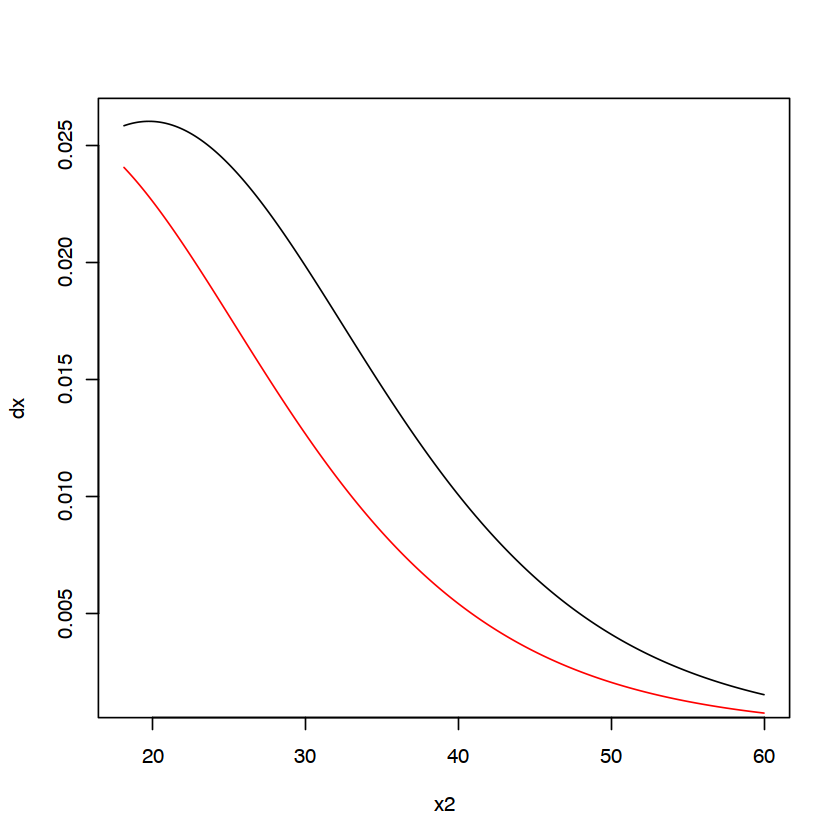

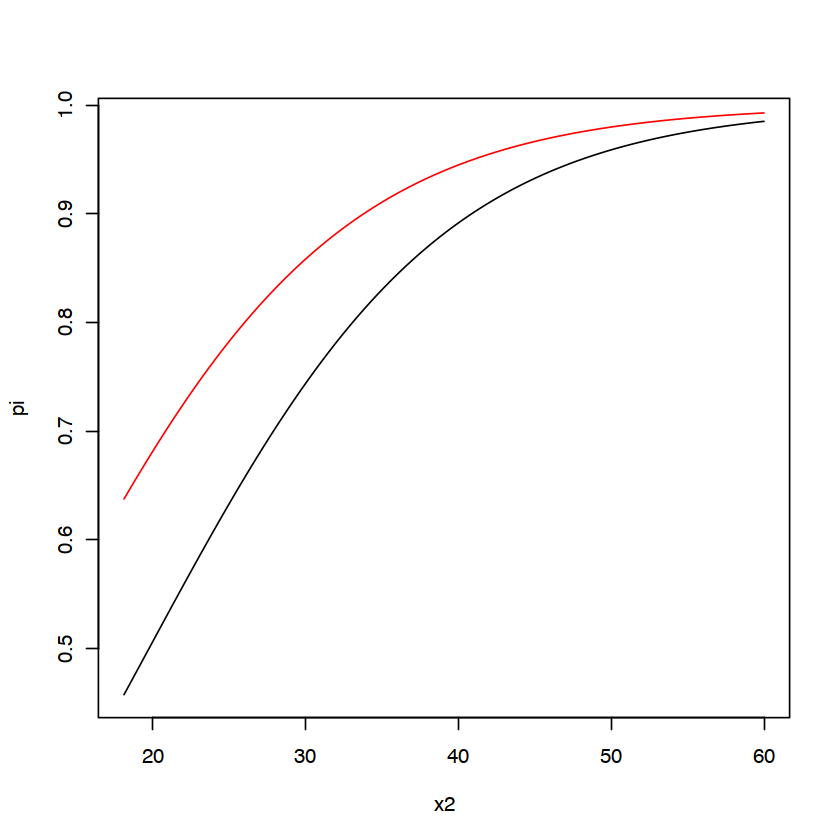

In [8]:
####Calculate for a range of x2 values and x3=0###

dx <-c()
for(i in 1:length(x2))
{
  pi<-exp(estim.par[1] + estim.par[2] * x2[i]+
          estim.par[3]*x3) / (1 + exp(estim.par[1] + estim.par[2] * x2[i]+estim.par[3]*x3))
  dx[i]<-estim.par[2]*(pi)*(1-pi) 
}

plot(x2,dx,type="l")
####Calculate for a range of x2 values and x3=1###
x3<-1
dx1<-c()
for(i in 1:length(x2))
{
  pi<-exp(estim.par[1] + estim.par[2] * x2[i]+
          estim.par[3]*x3) / (1 + exp(estim.par[1] + estim.par[2] * x2[i]+estim.par[3]*x3))
  dx1[i]<-estim.par[2]*(pi)*(1-pi) 
}
lines(x2,dx1,col="red")

#####Predicted probabilities for beta3######
x3<-0
pi<-c()
for(i in 1:length(x2))
{
  pi[i]<-exp(estim.par[1] + estim.par[2] * x2[i]+
             estim.par[3]*x3) / (1 + exp(estim.par[1] + estim.par[2] * x2[i]+estim.par[3]*x3))
  #dx[i]<-estim.par[2]*(pi)*(1-pi) 
}
plot(x2,pi,type="l")

#####Predicted probabilities for beta2######
x3<-1
pi1<-c()
for(i in 1:length(x2))
{
  pi1[i]<-exp(estim.par[1] + estim.par[2] * x2[i]+
              estim.par[3]*x3) / (1 + exp(estim.par[1] + estim.par[2] * x2[i]+estim.par[3]*x3))
  #dx[i]<-estim.par[2]*(pi)*(1-pi) 
}
lines(x2,pi1,col="red")

## Linear Discriminant Analysis

Before: we tried to model the conditional distribution of $Y$ given $X$. 

Now: we will model the distribution of the predictors $X$ separately in each of the response classes (i.e. given $Y$ ) and use Bayes’ theorem to flip these around into estimates for $\mathbb{P}(Y=k | X=x)$.

Why?

1. If the classes are well separated from each other, then the parameter estimates in the logistic regression are surprisingly unstable.
2. Logistic regression becomes more complicated when the number of classes is bigger than $2$.

### Before we begin: the Bayes classifier 

How to measure the accuracy of the method? Themost common approach for quantifying the accuracy of our estimate is
to calculate *the training error rate*,  the proportion of mistakes that are made if we apply our method to the training observations:

$$
\frac{1}{n}\sum_{i =1}^n \mathbb{1}(y_i \neq \hat{y}_i).
$$

Here $\hat{y}_i$ is the predicted class label for the $i$th observation using our classifier. And $\mathbb{1}(y_i \neq \hat{y}_i)$ is an indicator variable that equals $1$ if $y_i \neq \hat{y}_i$ and zero otherwise. In other words, if $\mathbb{1}(y_i \neq \hat{y}_i) = 0$, then the $i$th observation was classified correctly by our classification method; otherwise it was misclassified. Training error rate computes the fraction of incorrect classifications based on the *training set*.

The test error rate associated with a *new* set of test observations of the form $(x_i^\prime, y_i^\prime)$ is given by

$$
\text{Ave} \big(\mathbb{1}(y_i^\prime \neq \hat{y}_i^\prime)\big).
$$

A good classifier is one for which the test error is smallest.

We can show that test error rate given above is minimized, on average, by a very simple classifier that assigns each observation to the most likely class given its predictor values. 

Formally: we should assign a test observation with predictor vector $x_i^\prime$ to the class $j$ for which the conditional probability (i.e. the probability conditional that $Y = j$, given the observed predictor vector $x_i^\prime$)

\begin{equation*}
\mathbb{P}\left(Y=j|X= x_{i}^\prime\right)\label{eq:bayes}\tag{1}
\end{equation*}

is largest.

In a two-class problem where there are only two possible response values (class 1 or class 2), the Bayes classifier corresponds to predicting class 1 if $\mathbb{P}(Y = 1|X = x_i^\prime) > 0.5$, and class 2 otherwise.


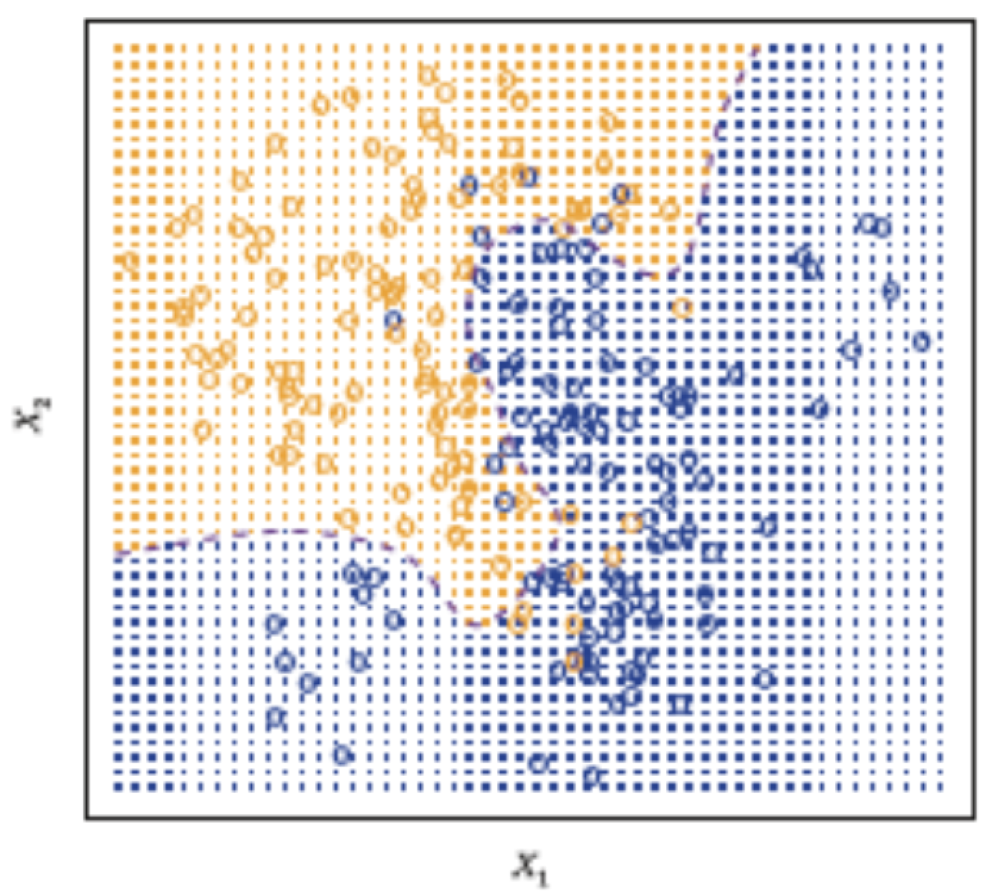

The Bayes classifier produces the lowest possible test error rate, Since the Bayes classifier will always choose the class for which \ref{eq:bayes} is largest, the error rate at $X = x_0$ will be 

$$1−max_j Pr(Y = j|X = x_0).$$

In general, the overall Bayes error rate is given by

$$1-E\left(\max_{j} \mathbb{P}(Y=j | X)\right)$$

where the expectation averages the probability over all possible values of
$X$.

### Setting

Suppose that we have $K$ classes with $K>2$. 

First, we define the following quantities:
- $\pi_k$ is the overall *prior* probability that a randomly chosen observation comes from the $k$th class;
- $f_{k}(X) \equiv \mathbb{P}(X=x | Y=k)$ is the density function of $X$ for an observation that comes from the $k$th class.

Then Bayes' theorem states that 

 \begin{equation*}
p_{k}(x)=\mathbb{P}(Y=k | X=x)=\frac{\pi_{k} f_{k}(x)}{\sum_{l=1}^{K} \pi_{l} f_{l}(x)}
\label{eq:bayes_theo} \tag{2}
\end{equation*}


and we call $p_{k}(\cdot)$ the posterior probability. 

Hence, in order to estimate $p_{k}(\cdot)$, we will need

- $\pi_k$. This is unconditional probability which we can compute from the sample.
- $f_k(\cdot)$. Can be challenging, we will need to make assumptions about functional form.

### LDA for one predictor

Suppose that we have only one predictor $x$. In what follows, we will assume that $f_k(x)$ is normal density: 

\begin{equation}
f_{k}(x)=\frac{1}{\sqrt{2 \pi} \sigma_{k}} \exp \left(-\frac{1}{2 \sigma_{k}^{2}}\left(x-\mu_{k}\right)^{2}\right)
\end{equation}

where $\mu_{k} \text { and } \sigma_{k}^{2}$ are the mean and variance parameters for the $k$th class.

Further suppose that $\sigma_{1}^{2}=\ldots=\sigma_{K}^{2}$, we can write equation \ref{eq:bayes_theo}

\begin{equation}
p_{k}(x)=\frac{\pi_{k} \frac{1}{\sqrt{2 \pi} \sigma} \exp \left(-\frac{1}{2 \sigma^{2}}\left(x-\mu_{k}\right)^{2}\right)}{\sum_{l=1}^{K} \pi_{l} \frac{1}{\sqrt{2 \pi} \sigma} \exp \left(-\frac{1}{2 \sigma^{2}}\left(x-\mu_{l}\right)^{2}\right)}\label{eq:bayes_norm}\tag{3}
\end{equation}

Bayes' classifier involves assigning an observation $X = x$ to the class for which equation \eqref{eq:bayes_norm}  is largest. Taking the log of \eqref{eq:bayes_norm}
and rearranging the terms, we can show that this is equivalent to
assigning the observation to the class for which the *discriminant function*

\begin{equation}\label{eq:lda_delta_x}
\delta_{k}(x)=x \cdot \frac{\mu_{k}}{\sigma^{2}}-\frac{\mu_{k}^{2}}{2 \sigma^{2}}+\log \left(\pi_{k}\right)
\end{equation}

is the largest.


For instance, if $ K = 2$ and $\pi_1 = \pi_2$, then the Bayes` classifier
assigns an observation to class 1 if $2x (\mu_1 − \mu_2) > \mu^2_1-\mu_2^2$, and to class
2 otherwise. In this case, the Bayes decision boundary corresponds to the
point where

\begin{equation*}
x=\frac{\mu_{1}^{2}-\mu_{2}^{2}}{2\left(\mu_{1}-\mu_{2}\right)}=\frac{\mu_{1}+\mu_{2}}{2}
\end{equation*}

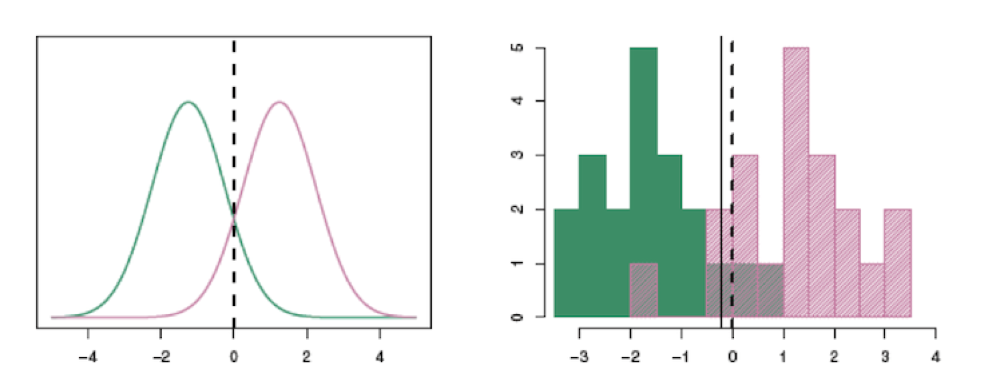

In applications, we are not able to calculate the Bayes classifier.

Even if we were certain that all $f_k$ are normal, we still need to estimate $\mu_1, \ldots, \mu_K, \pi_1, \ldots, \pi_K$ and $\sigma^2$.

In LDA, we use the following estimates:

\begin{equation}
\begin{aligned} \hat{\mu}_{k} &=\frac{1}{n_{k}} \sum_{i : y_{i}=k} x_{i} \\ \hat{\sigma}^{2} &=\frac{1}{n-K} \sum_{k=1}^{K} \sum_{i : y_{i}=k}\left(x_{i}-\hat{\mu}_{k}\right)^{2} \end{aligned}
\end{equation}


 where $n$ is the total number of training observations, and $n_k$ is the number
of training observations in the $k$th class.

 Without additional information about class membership, we estimate \begin{equation}
\hat{\pi}_{k}=\frac{n_{k}}{n}.
\end{equation}


Finally, by plugging these estimates in the formula for $\delta_k{x}$, we get the following:

\begin{equation}
\hat{\delta}_{k}(x)=x \cdot \frac{\hat{\mu}_{k}}{\hat{\sigma}^{2}}-\frac{\hat{\mu}_{k}^{2}}{2 \hat{\sigma}^{2}}+\log \left(\hat{\pi}_{k}\right),
\end{equation}

where the discriminant factor $\delta$ is a linear function of $x$ (hence the name). 

### LDA for more than one predictor 

We assume that $\mathbf{X}=\left(X_{1}, X_{2}, \ldots, X_{p}\right)$ is drawn from a multivariate with a *class-specific* multivariate mean vector $\boldsymbol{\mu}_k$ and a common covariance matrix $\mathbf{\Sigma}$.
 
After plugging the density function for the $k$th class, $f_{k}(X=x)$, into the Bayes theorem, it can be shown that the Bayes classifier assigns an observation $X = x$ to the class for which

\begin{equation*}
\delta_{k}(\mathbf{x})=\mathbf{x}^{T} \boldsymbol{\Sigma}^{-1} \boldsymbol{\mu}_{k}-\frac{1}{2} _{k} \boldsymbol{\mu}_k^\top\boldsymbol{\Sigma}^{-1} \boldsymbol{\mu}_{k}+\log \pi_{k}\label{eq:lda_mult}\tag{4}
\end{equation*}

is largest.

The decision boundaries represent the set of values for which $\delta_k(\mathbf{x})=\delta_l(\mathbf{x})$
 
\begin{equation}
\mathbf{x}^{T} \boldsymbol{\Sigma}^{-1} \boldsymbol{\mu}_{k}-\frac{1}{2} \boldsymbol{\mu}_{k}^{T} \boldsymbol{\Sigma}^{-1} \boldsymbol{\mu}_{k}=\mathbf{x}^{T} \boldsymbol{\Sigma}^{-1} \boldsymbol{\mu}_{l}-\frac{1}{2} \boldsymbol{\mu}_{l}^{T} \boldsymbol{\Sigma}^{-1} \boldsymbol{\mu}_{l}
\end{equation}

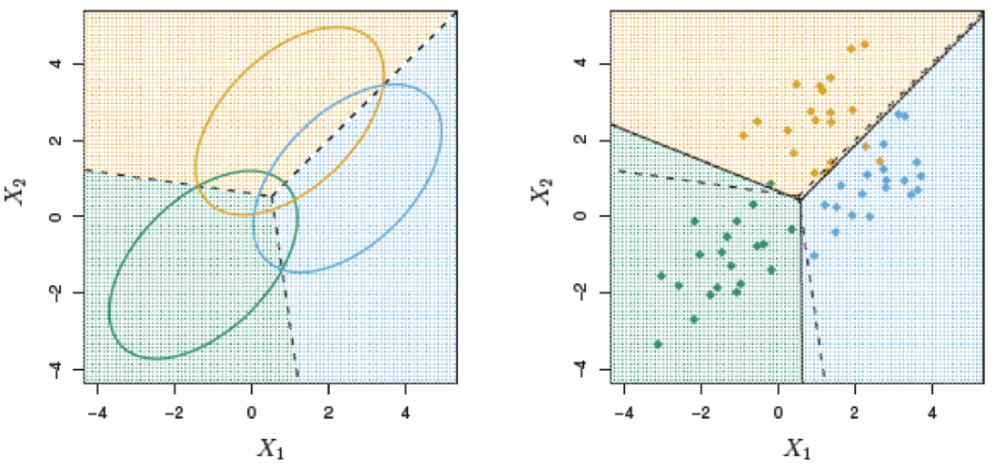

The algorithm is as before:
- estimate $\boldsymbol{\mu}_1,...,\boldsymbol{\mu}_k$, $\pi_1,...,\pi_k$ and $\boldsymbol{\Sigma}$ from training data;
- plug these estimates into \ref{eq:lda_mult} and classifies a new observation with $X = x$ to the class for which the value is largest.

### Sensitivity, specificity and total error

**Example: Default Data**
We can perform LDA on the Default data in order to predict whether or not an individual will default on the basis of credit card balance and student status. The LDA model fit to the 10, 000 training samples results in a training error rate of 2.75\%. Is this low?

1. Training error rates will usually be lower than test error rates.
2. In the dataset, only 3.33\% of the individuals in the training sample defaulted, hence, we can use a simple but absolutely useless classifier: nobody defaults. The error rate of a null classifier will then only be 3.33\%!

Here the problems are:
- overall error rate is low
- error rate among individuals who defaulted is very high.

![errors.jpg](errors.jpg)
 
Need classifiers that can accommodate class-specific performance: *sensitivity* (correctly identified defaulters) and *specificity* (correctly identified non-defaulters).

In this case the sensitivity is low, only $24.3\%$. On the other hand, the specificity is very high here, $(1-23/9\, 667)× 100 = 99.8\%$. 

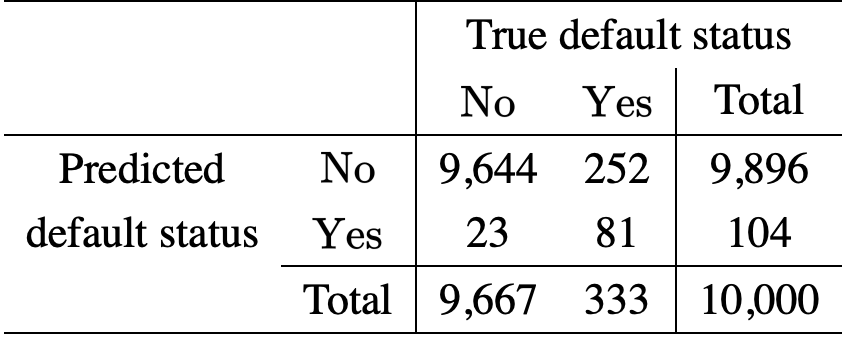

As we have seen, LDA is trying to approximate the Bayes classifier, which has the lowest *total* error rate out of all classifiers. 


The Bayes classifier works by assigning an observation to the class for which the posterior probability is the largest. In the two class case: assign an observation to the `default` class if 

\begin{equation}
\mathbb{P}(\text{default} = \text{Yes} | X=x)>0.5
\end{equation}

Bayes classifier (and by extension LDA), uses a threshold of 50\% for the posterior probability of default in order to assign an observation to the `default` class. 

However, if we are concerned about incorrectly predicting the default status for individuals who default, then we can consider lowering this threshold. For instance, we might label any customer with a posterior probability of default above 20\% to the default class.

\begin{equation}
P(\text{default} = \text{Yes} | X=x)>0.2
\end{equation}

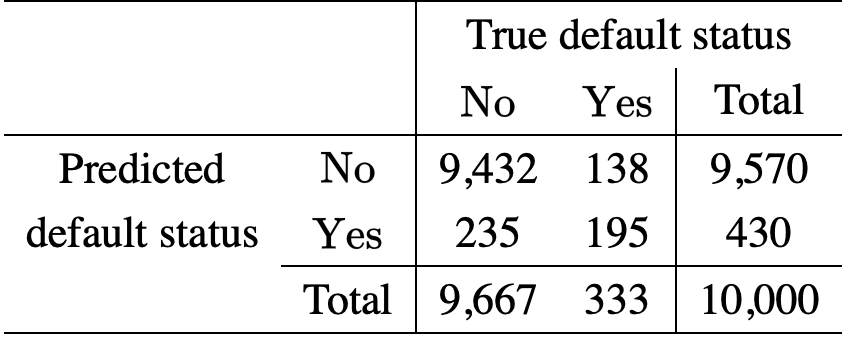

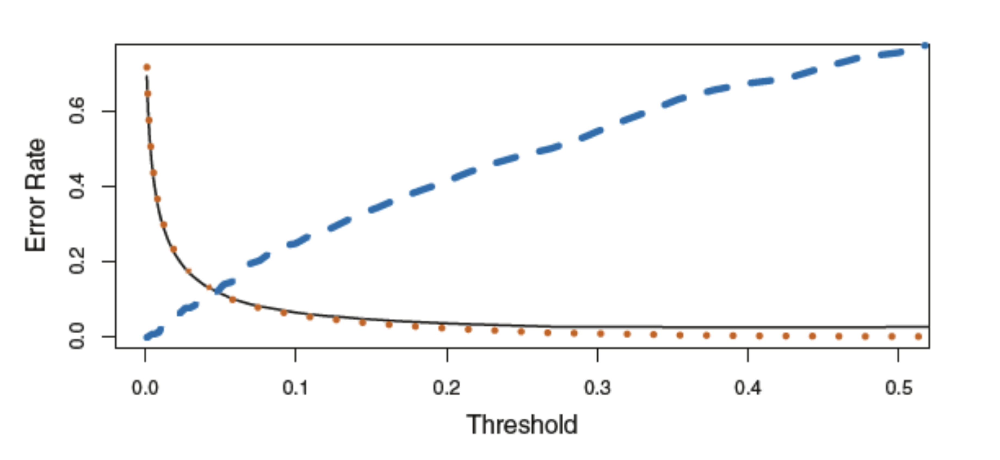

The ROC curve: simultaneously displays the two types of errors for all possible thresholds. The overall performance of a classifier, summarized overl all possible thresholds, is given by the area under the curve (AUC).

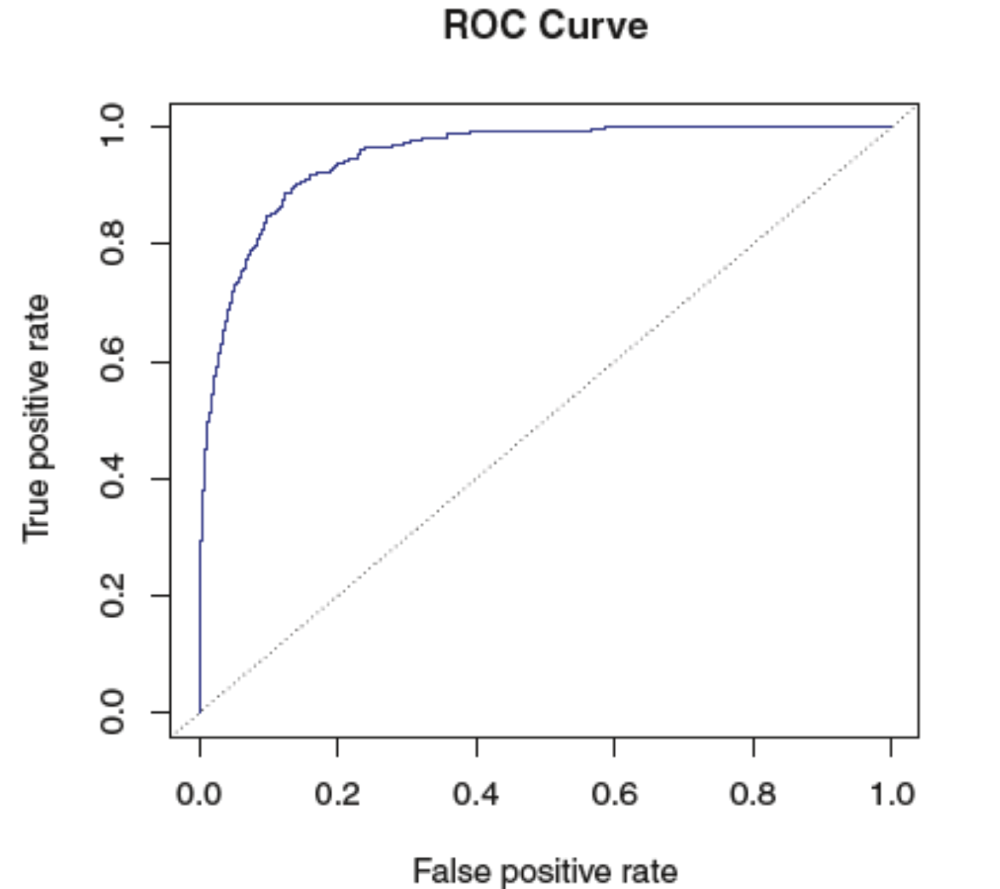

## Quadratic Discriminant Analysis

_Quadratic discriminant analysis (QDA)_ classifier also results from assuming that the observations from each class are drawn from a Gaussian distribution, and plugging estimates for the parameters into Bayes' theorem in order to perform prediction. 

However, unlike LDA, QDA assumes that each class has its _own_ covariance matrix, i.e. observation from the
$k$th class is of the form $\boldsymbol{X} \sim N\left(\boldsymbol{\mu}_{k}, \boldsymbol{\Sigma}_{k}\right)$ where $\boldsymbol{\Sigma}_{k}$ is a covariance matrix for the $k$th class. Under this assumption, the Bayes classifier assigns an observation $\boldsymbol{X} = \boldsymbol{x}$ to the class for which

$$
\begin{aligned}
 \delta_{k}(\boldsymbol{x}) &=-\frac{1}{2}\left(\boldsymbol{x}-\boldsymbol{\mu}_{k}\right)^{T} \boldsymbol{\Sigma}_{k}^{-1}\left(\boldsymbol{x}-\boldsymbol{\mu}_{k}\right)+\log \pi_{k} \\
 &=-\frac{1}{2} \boldsymbol{x}^{T} \boldsymbol{\Sigma}_{k}^{-1} \boldsymbol{x}+\boldsymbol{x}^{T} \boldsymbol{\Sigma}_{k}^{-1} \boldsymbol{\mu}_{k}-\frac{1}{2} \mu_{k}^{T} \boldsymbol{\Sigma}_{k}^{-1} \boldsymbol{\mu}_{k}+\log \pi_{k} 
\end{aligned}
$$

is largest. Unlike before, here $\delta_{k}(\boldsymbol{x})$ is a quadratic function of $\boldsymbol{x}$.


Hence, QDA classifier requires estimates for $\boldsymbol{\Sigma}_{k}, \boldsymbol{\mu}_{k}$ and $\pi_k$.

### Why would one prefer LDA to QDA or vice-versa? 

The answer lies in the bias-variance trade-off. With $p$ predictors estimating a covariance matrix entails estimating $p(p+1)/2$ parameters. QDA requires estimating covariance matrix for each class

$\quad\Rightarrow\quad$ a total number of $K \, p(p+1)/2 $ parameters. 

By instead assuming that the $K$ classes share a common covariance matrix, the LDA model becomes linear in $x$, which means there are $Kp$ linear coefficients to estimate. Consequently, LDA is a much less flexible classifier than QDA $\rightarrow$ lower variance.


But if LDA’s assumption that the K classes share a common covariance matrix is badly off, then LDA suffers from high bias!

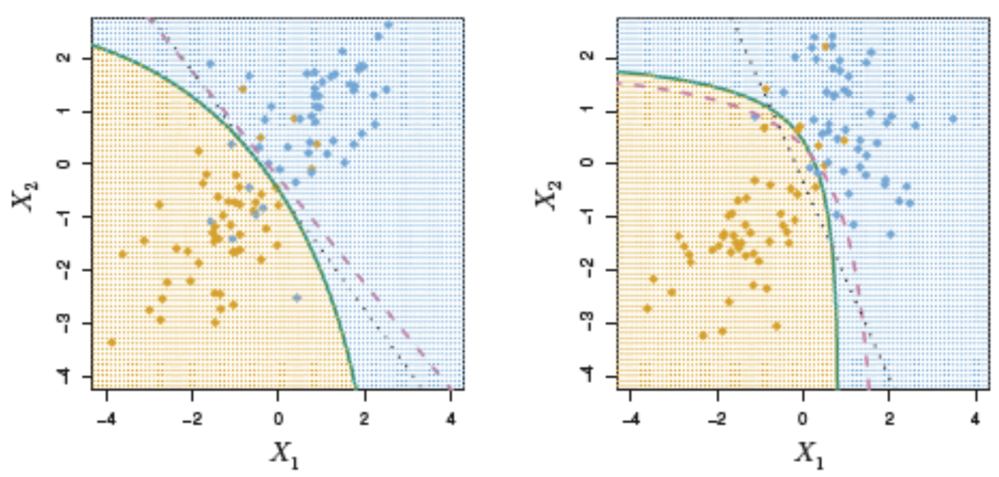

## $k$-nearest neighbor

Given a positive integer $K$ and a test observation $x_0$, $k$-nearest neighbours classifier first identifies the $k$ points in the training data that are closest to $x_0$, represented by $\mathcal{N}_{0}$, and then estimates the conditional probability for class $j$ as the fraction of points in $\mathcal{N}_{0}$ whose response values equal $j$:

$$
\mathbf{P}\left(Y=j | X=x_{0}\right)=\frac{1}{k} \sum_{i \in \mathcal{N}_{0}} \mathbb{1}\left(y_{i}=j\right)
$$

Finally, $k$-nearest neighbours applies Bayes rule and classifies the test observation $x_0$ to the class with the largest probability.

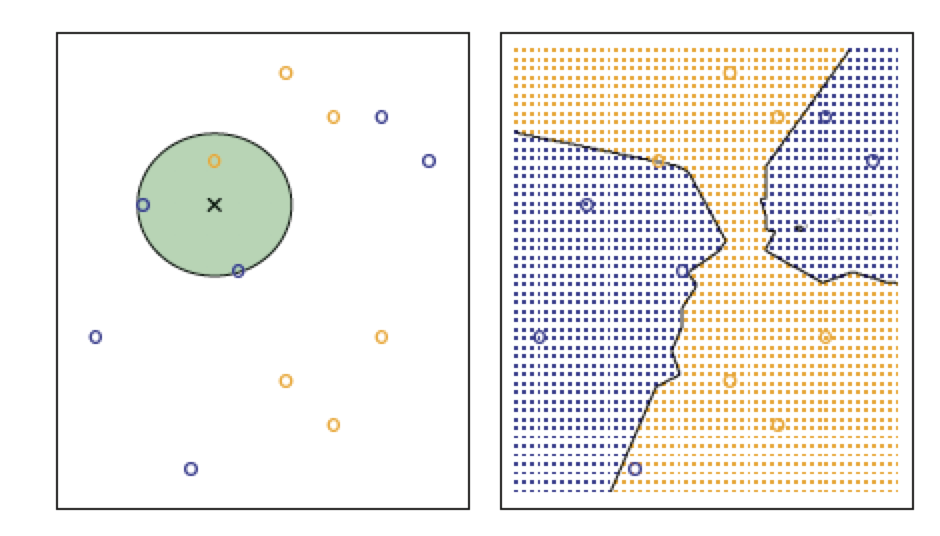

![fig_K_neighbor.png](fig_K_neighbor.png)

![fig_knn_error_rates.png](fig_knn_error_rates.png)



## Comparison of Classification Methods

__Logistic regression and LDA__: linear decision boundaries. The main difference is the way the coefficients are estimated (plus assumptions on the DGP).


__LDA__: observations are drawn from a Gaussian distribution with a common covariance matrix in each class.

- If that is the case, than LDA$>$logistic regression.
- if that is not the case, than LDA$<$logistic regression.


__KNN__: nonparametric approach. no assumptions about the shape of the decision boundary, i.e. KNN performs better than LDA and logistic regression when the decision boundary is highly non-linear. But we don't estimate coefficients!

__QDA__: compromise between the non-parametric KNN
method and the linear LDA and logistic regression approaches. Not as flexible as KNN, but performs better with limited number of training observations. 

